In [1]:
import os
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
pd.options.display.max_rows = 100
pd.options.display.max_columns = 100
pd.set_option('display.max_colwidth', None)
from scipy.spatial.distance import cdist
import warnings
warnings.filterwarnings('ignore')
from datetime import datetime

In [2]:
with open('dtypes.json', 'r') as f:
    loaded_dtypes = json.load(f)  

In [3]:
loaded_dtypes

{'Age': 'float64',
 'Gender': 'category',
 'Annual Income': 'float64',
 'Marital Status': 'category',
 'Number of Dependents': 'category',
 'Education Level': 'category',
 'Occupation': 'category',
 'Health Score': 'float64',
 'Location': 'category',
 'Policy Type': 'category',
 'Previous Claims': 'category',
 'Vehicle Age': 'int64',
 'Credit Score': 'float64',
 'Insurance Duration': 'category',
 'Premium Amount': 'float64',
 'Customer Feedback': 'category',
 'Smoking Status': 'category',
 'Exercise Frequency': 'category',
 'Property Type': 'category'}

In [4]:
df = pd.read_csv('cleaned_df_insurance.csv', dtype=loaded_dtypes,\
                 parse_dates=['Policy Start Date'], date_parser=lambda x: pd.to_datetime(x).strftime("%Y-%m-%d"))

In [5]:
df.shape

(257319, 20)

In [6]:
df.head()

,Age,Gender,Annual Income,Marital Status,Number of Dependents,Education Level,Occupation,Health Score,Location,Policy Type,Previous Claims,Vehicle Age,Credit Score,Insurance Duration,Premium Amount,Policy Start Date,Customer Feedback,Smoking Status,Exercise Frequency,Property Type
0,56.0,Male,99990.0,Married,1.0,Master's,Self-Employed,31.074627,Urban,Comprehensive,1.0,13,320.000000,5,308.0,2022-12-10,Poor,Yes,Daily,Condo
1,46.0,Male,2867.0,Single,1.0,Bachelor's,Self-Employed,50.271335,Urban,Comprehensive,1.0,3,694.000000,4,517.0,2023-01-31,Good,Yes,Monthly,House
2,32.0,Female,30154.0,Divorced,3.0,Bachelor's,Self-Employed,14.714909,Suburban,Comprehensive,2.0,16,652.000000,8,849.0,2023-11-26,Poor,No,Monthly,House
3,60.0,Female,48371.0,Divorced,0.0,PhD,Self-Employed,25.346926,Rural,Comprehensive,1.0,11,330.000000,7,927.0,2023-02-27,Poor,No,Rarely,Condo
4,25.0,Female,54174.0,Divorced,0.0,High School,Self-Employed,6.659499,Urban,Comprehensive,1.0,9,574.389365,8,303.0,2020-11-25,Poor,No,Rarely,Condo


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 257319 entries, 0 to 257318
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Age                   257319 non-null  float64       
 1   Gender                257319 non-null  category      
 2   Annual Income         257319 non-null  float64       
 3   Marital Status        257319 non-null  category      
 4   Number of Dependents  257319 non-null  category      
 5   Education Level       257319 non-null  category      
 6   Occupation            257319 non-null  category      
 7   Health Score          257319 non-null  float64       
 8   Location              257319 non-null  category      
 9   Policy Type           257319 non-null  category      
 10  Previous Claims       257319 non-null  category      
 11  Vehicle Age           257319 non-null  int64         
 12  Credit Score          257319 non-null  float64       
 13 

In [8]:
df['Marital Status'].nunique()

3

In [36]:
df.describe()

,Age,Annual Income,Health Score,Vehicle Age,Credit Score,Premium Amount,Policy Start Date
count,257319.000000,257319.000000,257319.000000,257319.000000,257319.000000,257319.000000,257319
mean,41.012393,42090.605965,28.587099,9.517389,574.396012,966.775769,2022-02-14 22:12:06.690217472
min,18.000000,0.000000,0.035436,0.000000,300.000000,0.000000,2019-08-17 00:00:00
25%,29.000000,14399.500000,16.145204,5.000000,452.000000,286.000000,2020-11-17 00:00:00
50%,41.000000,34682.000000,26.446137,10.000000,574.389365,688.000000,2022-02-16 00:00:00
75%,53.000000,60073.500000,38.974351,15.000000,697.000000,1367.000000,2023-05-16 00:00:00
max,64.000000,149997.000000,93.876090,19.000000,849.000000,4999.000000,2024-08-15 00:00:00
std,13.552276,34536.882037,15.972296,5.766249,150.650661,909.840053,NaN


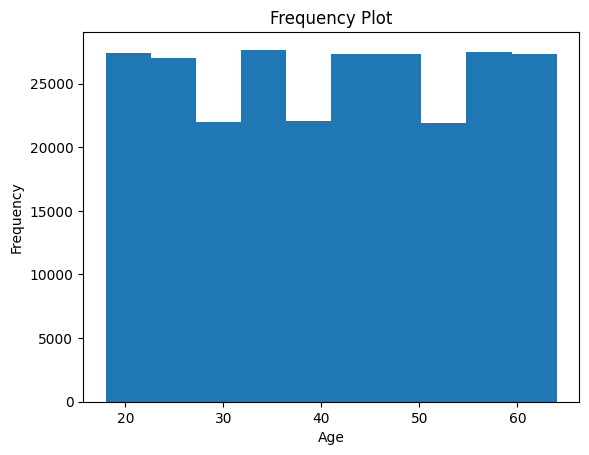

In [37]:
plt.hist(df['Age'], bins=10)
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.title('Frequency Plot')
plt.show()

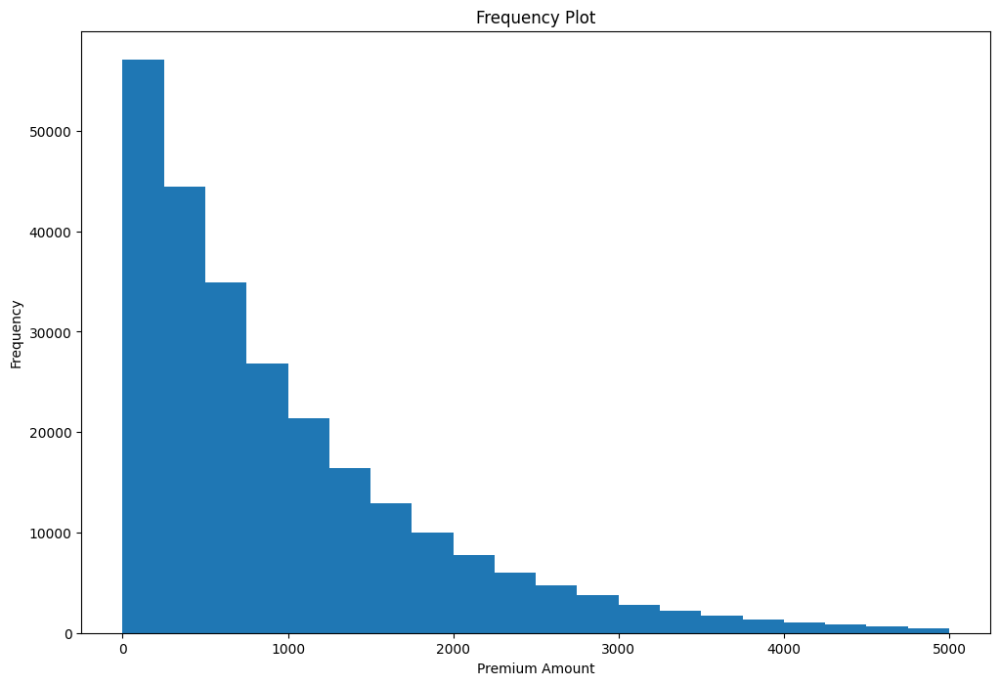

In [39]:
plt.figure(figsize=(12,8))
plt.hist(df['Premium Amount'],bins=20)
plt.xlabel('Premium Amount')
plt.ylabel('Frequency')
plt.title('Frequency Plot')
plt.show()

In [40]:
import plotly.express as px
import plotly.graph_objects as go

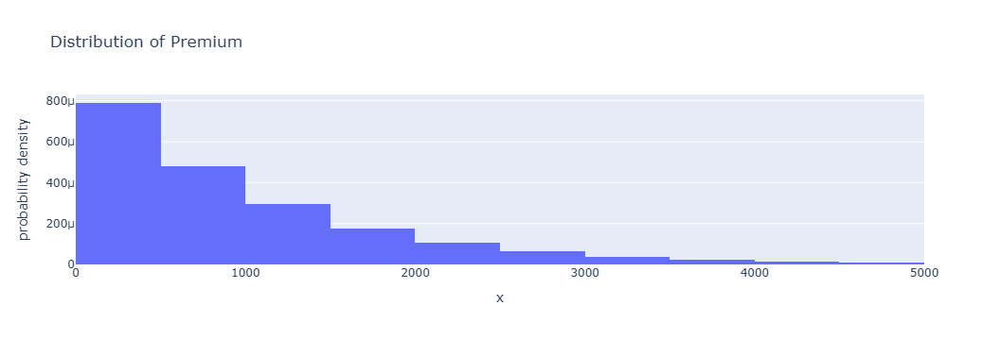

In [43]:
## Use plotly express histogram chart function px.histogram.Provide input data x to the histogram
fig = px.histogram(x=df['Premium Amount'],title="Distribution of Premium", nbins=20)
fig.show()

In [11]:
!pip install dash

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 38.7 MB/s eta 0:00:0000:01


In [12]:
from dash import Dash, dcc, html, Input, Output
import plotly.express as px

app = Dash(__name__)


app.layout = html.Div([
    html.H4('Restaurant tips by day of week'),
    dcc.Dropdown(
        id="dropdown",
        options=["Married", "Single", "Divorced"],
        value="Single",
        clearable=False,
    ),
    dcc.Graph(id="graph"),
])


@app.callback(
    Output("graph", "figure"), 
    Input("dropdown", "value"))
def update_bar_chart(marital_status):
    data = df.copy() # replace with your own data source
    mask = data["Marital Status"] == marital_status
    fig = px.bar(data[mask], x="Gender", y="Premium Amount", 
                 color="Smoking Status", barmode="group")
    return fig


app.run_server(debug=True)

In [9]:
df.head()

,Age,Gender,Annual Income,Marital Status,Number of Dependents,Education Level,Occupation,Health Score,Location,Policy Type,Previous Claims,Vehicle Age,Credit Score,Insurance Duration,Premium Amount,Policy Start Date,Customer Feedback,Smoking Status,Exercise Frequency,Property Type
0,56.0,Male,99990.0,Married,1.0,Master's,Self-Employed,31.074627,Urban,Comprehensive,1.0,13,320.000000,5,308.0,2022-12-10,Poor,Yes,Daily,Condo
1,46.0,Male,2867.0,Single,1.0,Bachelor's,Self-Employed,50.271335,Urban,Comprehensive,1.0,3,694.000000,4,517.0,2023-01-31,Good,Yes,Monthly,House
2,32.0,Female,30154.0,Divorced,3.0,Bachelor's,Self-Employed,14.714909,Suburban,Comprehensive,2.0,16,652.000000,8,849.0,2023-11-26,Poor,No,Monthly,House
3,60.0,Female,48371.0,Divorced,0.0,PhD,Self-Employed,25.346926,Rural,Comprehensive,1.0,11,330.000000,7,927.0,2023-02-27,Poor,No,Rarely,Condo
4,25.0,Female,54174.0,Divorced,0.0,High School,Self-Employed,6.659499,Urban,Comprehensive,1.0,9,574.389365,8,303.0,2020-11-25,Poor,No,Rarely,Condo


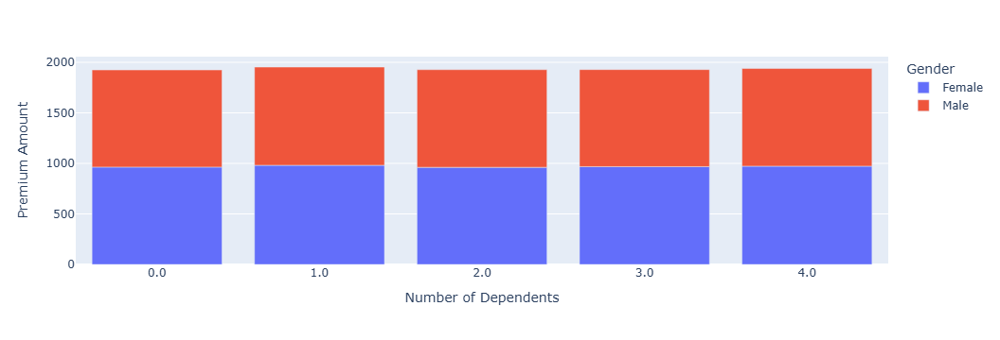

In [19]:
gb1 = df.groupby(['Number of Dependents','Gender'])['Premium Amount'].mean().reset_index()
fig = px.bar(gb1, x='Number of Dependents', y='Premium Amount', color='Gender')
fig.show()

In [ ]:
gb1 = df.groupby(['Number of Dependents','Gender'])['Premium Amount'].mean().reset_index()
fig = px.bar(gb1, x='Number of Dependents', y='Premium Amount', color='Gender')
fig.show()

## Multivariate analysis

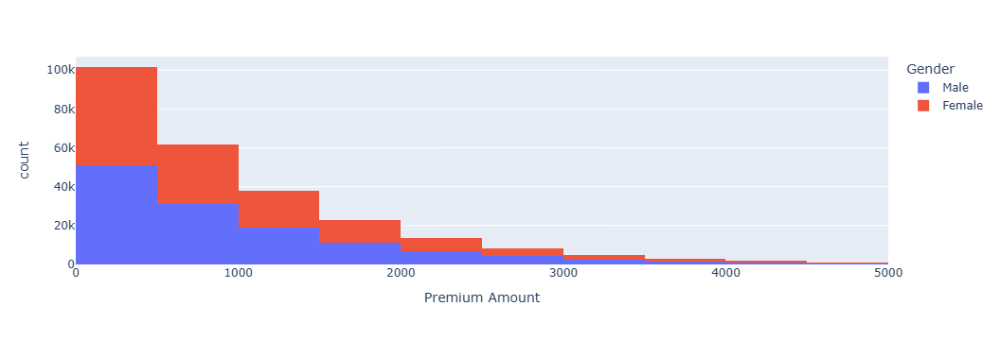

In [45]:
fig = px.histogram(df, x="Premium Amount", color="Gender", nbins=20)
fig.show()

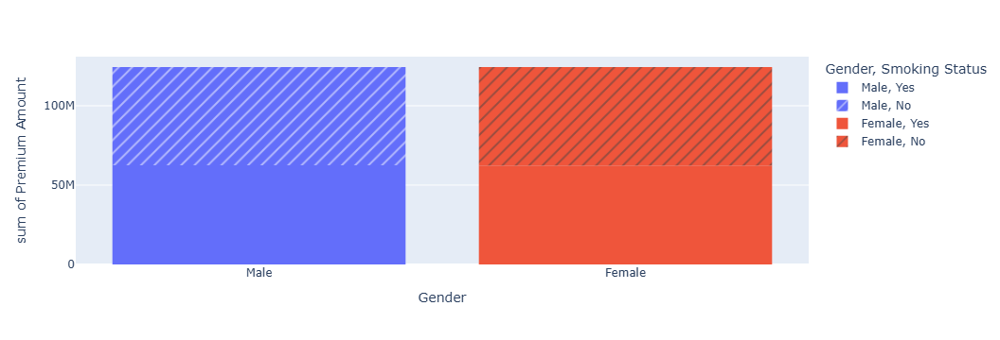

In [48]:
fig = px.histogram(df, x="Gender", color='Gender', y="Premium Amount", pattern_shape='Smoking Status')
fig.show()